# Principal component analysis

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
import scanpy as sc
import pandas as pd
import anndata


`dataset_old` and `dataset_5k` are now the filtered versions of the datasets such that they both contain the same genes. 

In [4]:
dataset_old = anndata.read_h5ad("/Users/isabelgiray/Desktop/TUM/Hiwi/Isabel_Hiwi/old_filtered_results.h5ad")
dataset_5k = anndata.read_h5ad("/Users/isabelgiray/Desktop/TUM/Hiwi/Isabel_Hiwi/5k_filtered_results.h5ad")

In [5]:
sc.tl.pca(dataset_old, svd_solver="arpack", use_highly_variable=False) 
sc.tl.pca(dataset_5k, svd_solver="arpack", use_highly_variable=False)

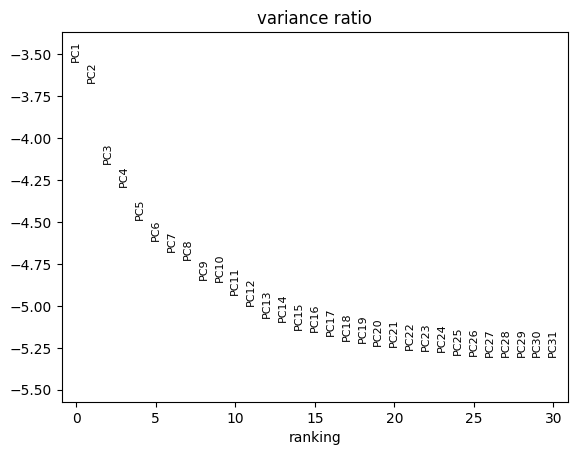

In [6]:
sc.pl.pca_variance_ratio(dataset_old, log=True)

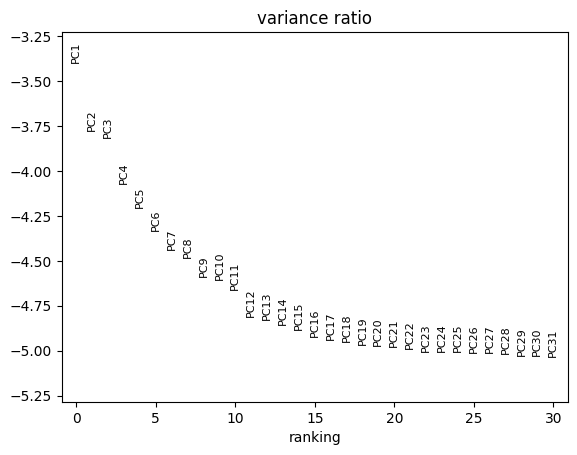

In [7]:
sc.pl.pca_variance_ratio(dataset_5k, log=True)

In [10]:
sc.pp.neighbors(dataset_old)
sc.pp.neighbors(dataset_5k) 


In [11]:
sc.tl.umap(dataset_old)

In [12]:
sc.tl.umap(dataset_5k)

In [15]:
sc.tl.leiden(
    dataset_old,
    resolution=0.9,
    random_state=0,
    #flavor="igraph",
    n_iterations=2, ###Resolution changed from 0.9 to 0.1 
    directed=False,
)

In [16]:
sc.tl.leiden(
    dataset_5k,
    resolution=0.9,
    random_state=0,
    #flavor="igraph",
    n_iterations=2, ###Resolution changed from 0.9 to 0.1 
    directed=False,
)

/Users/isabelgiray/anaconda3/envs/insitupy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/isabelgiray/anaconda3/envs/insitupy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


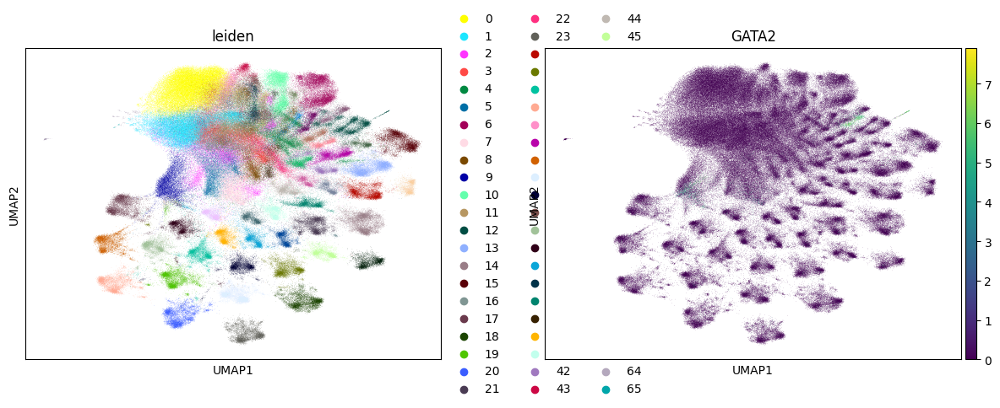

In [17]:
sc.pl.umap(dataset_old, color = ["leiden",'GATA2'])
#rs 0.1

/Users/isabelgiray/anaconda3/envs/insitupy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/isabelgiray/anaconda3/envs/insitupy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


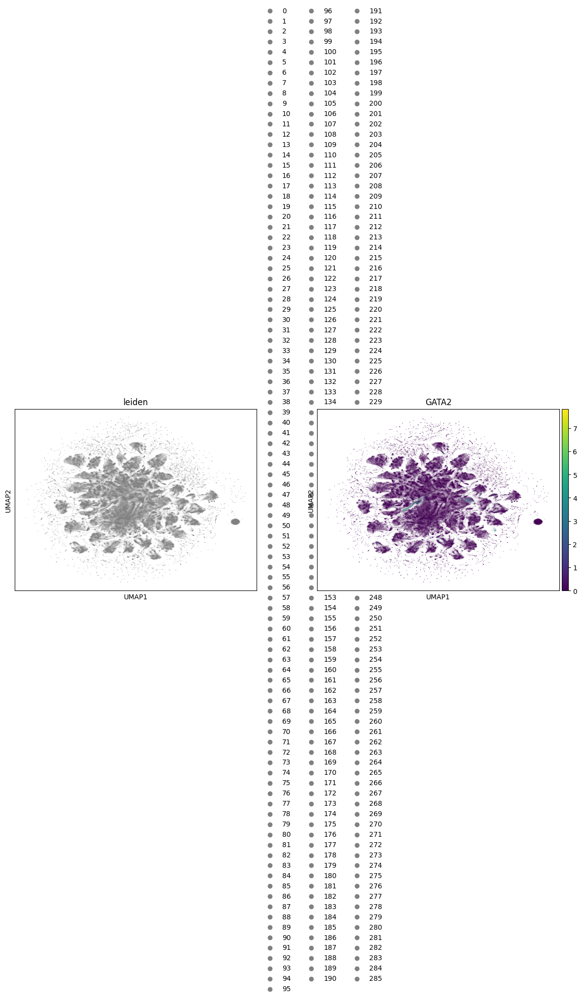

In [19]:
sc.pl.umap(dataset_5k, color = ["leiden",'GATA2'])

/Users/isabelgiray/anaconda3/envs/insitupy/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/Users/isabelgiray/anaconda3/envs/insitupy/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:398: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/Users/isabelgiray/anaconda3/envs/insitupy/lib/python3.9/site-packages/scanpy/tools/_rank_genes_g

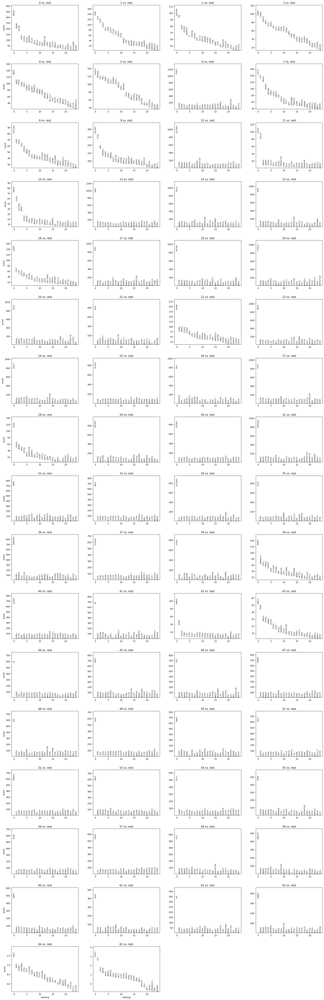

In [21]:
sc.tl.rank_genes_groups(dataset_old, "leiden", method="t-test")
sc.pl.rank_genes_groups(dataset_old, n_genes=25, sharey=False)

In [23]:
sc.tl.rank_genes_groups(dataset_5k, "leiden", method="t-test")
sc.pl.rank_genes_groups(dataset_5k, n_genes=25, sharey=False)

/Users/isabelgiray/anaconda3/envs/insitupy/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/Users/isabelgiray/anaconda3/envs/insitupy/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:398: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/Users/isabelgiray/anaconda3/envs/insitupy/lib/python3.9/site-packages/scanpy/tools/_rank_genes_g

/Users/isabelgiray/anaconda3/envs/insitupy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/isabelgiray/anaconda3/envs/insitupy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()


/Users/isabelgiray/anaconda3/envs/insitupy/lib/python3.9/site-packages/scanpy/tools/_dendrogram.py:135: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_df = rep_df.groupby(level=0).mean()
/Users/isabelgiray/anaconda3/envs/insitupy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


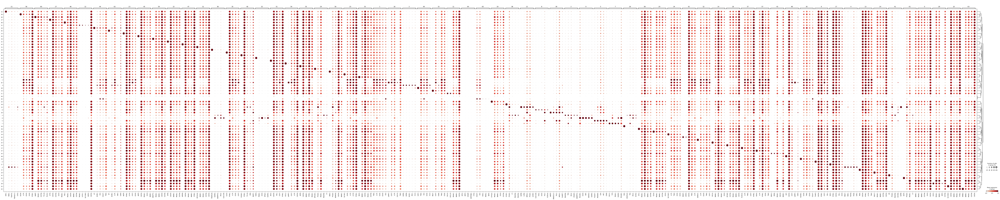

In [24]:
sc.pl.rank_genes_groups_dotplot(
    dataset_old, groupby="leiden", standard_scale="var", n_genes=5
)

In [25]:
sc.pl.rank_genes_groups_dotplot(
    dataset_5k, groupby="leiden", standard_scale="var", n_genes=5
)

/Users/isabelgiray/anaconda3/envs/insitupy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/isabelgiray/anaconda3/envs/insitupy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()


/Users/isabelgiray/anaconda3/envs/insitupy/lib/python3.9/site-packages/scanpy/tools/_dendrogram.py:135: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_df = rep_df.groupby(level=0).mean()
/Users/isabelgiray/anaconda3/envs/insitupy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)
